In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input director
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
! conda install -y gdown

Retrieving notices: ...working... done
Channels:
 - rapidsai
 - nvidia
 - nodefaults
 - conda-forge
 - defaults
 - pytorch
Platform: linux-64
Solving environment: \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ done

## Package Plan ##

  environment location: /opt/conda

  added / updated specs:
    - gdown


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    conda-24.9.2               |  py310hff52083_0         895 KB  conda-forge
    filelock-3.16.1            |     pyhd8ed1ab_0          17 KB  conda-forge
    gdown-5.2.0                |     pyhd8ed1ab_0          21 KB  conda-forge
    ------------------------------------------------------------
                                           Total:         933 KB

The following NEW packages will be INSTALLED:

  filelock           conda-forge

In [3]:
!gdown --id 1wH6_T-Thjm95_kCrH7dNgLRBh2Qm-I6e

/opt/conda/lib/python3.10/site-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1wH6_T-Thjm95_kCrH7dNgLRBh2Qm-I6e
From (redirected): https://drive.google.com/uc?id=1wH6_T-Thjm95_kCrH7dNgLRBh2Qm-I6e&confirm=t&uuid=3e1a84b2-1f57-487f-b220-1eb7c3e1bc19
To: /kaggle/working/Cars_OCR.zip
100%|████████████████████████████████████████| 213M/213M [00:03<00:00, 69.2MB/s]


In [4]:
import zipfile

z= zipfile.ZipFile('Cars_OCR.zip')

z.extractall()

# Reading Libraries

In [5]:
import os

import cv2

import numpy as np

from PIL import Image

import pandas as pd

import matplotlib.pyplot as plt

import xml.etree.ElementTree as ET

from sklearn.model_selection import train_test_split

from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.applications import EfficientNetB3

from tensorflow.keras.models import Model,Sequential

from tensorflow.keras.layers import Dense, GlobalAveragePooling2D,Dropout,Reshape,BatchNormalization,Input,Conv2D,MaxPooling2D,Flatten, concatenate, UpSampling2D, Add,Multiply

from tensorflow.keras.optimizers import Adam

import tensorflow as tf

from tensorflow import keras

from tensorflow.keras.callbacks import EarlyStopping,ReduceLROnPlateau,ModelCheckpoint

from sklearn.metrics import mean_squared_error

from tensorflow.keras.applications import EfficientNetB0,ResNet50,ResNet50V2,VGG16,MobileNetV2

from tensorflow.keras.callbacks import Callback

from tensorflow.keras.preprocessing.image import load_img, img_to_array

import imgaug.augmenters as iaa

from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage

from tensorflow.keras.losses import MeanSquaredError,Huber

from tensorflow.keras.regularizers import l2

from tensorflow.keras import layers, models, applications, optimizers

import albumentations as A

/opt/conda/lib/python3.10/site-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.18 (you have 1.4.17). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


# Reading Data

In [6]:
# Define directories
images_dir = "/kaggle/working/images"  # Directory with images
annotations_dir = "/kaggle/working/annotations"  # Directory with XML files


# Define Constants

In [7]:
# Constants
# Constants
IMAGE_SIZE = 224
BATCH_SIZE = 32
EPOCHS = 500
WIDTH, HEIGHT = 224, 224


# PreProcessing

In [8]:
# Set random seeds for reproducibility
def set_seeds(seed=42):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    os.environ['TF_DETERMINISTIC_OPS'] = '1'

set_seeds()

In [9]:
# Function to parse annotation XML
def parse_annotation(annotation_path):
    tree = ET.parse(annotation_path)
    root = tree.getroot()
    filename = root.find('filename').text
    size = root.find('size')
    width = int(size.find('width').text)
    height = int(size.find('height').text)
    for obj in root.findall('object'):
        if obj.find('name').text == 'licence':
            bndbox = obj.find('bndbox')
            xmin = int(bndbox.find('xmin').text)
            ymin = int(bndbox.find('ymin').text)
            xmax = int(bndbox.find('xmax').text)
            ymax = int(bndbox.find('ymax').text)
            # Normalize bounding box coordinates
            xmin, xmax = xmin / width, xmax / width
            ymin, ymax = ymin / height, ymax / height
            return filename, xmin, ymin, xmax, ymax
    return None, None, None, None, None

In [10]:
# Load and prepare the dataset
def load_dataset(annotations_dir):
    dataset = {
        "image_name": [],
        "top_x": [],
        "top_y": [],
        "bottom_x": [],
        "bottom_y": []
    }
    for xml_file in os.listdir(annotations_dir):
        if xml_file.endswith('.xml'):
            xml_path = os.path.join(annotations_dir, xml_file)
            filename, xmin, ymin, xmax, ymax = parse_annotation(xml_path)
            if filename:
                dataset["image_name"].append(filename)
                dataset["top_x"].append(xmin)
                dataset["top_y"].append(ymin)
                dataset["bottom_x"].append(xmax)
                dataset["bottom_y"].append(ymax)
    return pd.DataFrame(dataset)




In [11]:
# Visualization function
def visualize_sample(df, index, images_dir):
    sample = df.iloc[index]
    img_path = os.path.join(images_dir, sample['image_name'])
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]
    
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.plot([sample['top_x'] * w, sample['bottom_x'] * w, sample['bottom_x'] * w, sample['top_x'] * w, sample['top_x'] * w],
             [sample['top_y'] * h, sample['top_y'] * h, sample['bottom_y'] * h, sample['bottom_y'] * h, sample['top_y'] * h], 'r-')
    plt.title(f"Sample {index}")
    plt.show()

In [12]:
# Preprocess image function
def preprocess_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, [IMAGE_SIZE, IMAGE_SIZE])
    img = tf.keras.applications.efficientnet.preprocess_input(img)
    return img

In [13]:

# Load data function
def load_data(image_name, bbox, images_dir):
    image_path = tf.strings.join([images_dir, image_name], separator="/")
    image = preprocess_image(image_path)
    return image, bbox

In [14]:
# Data augmentation
def augment_data(image, label):
    image = tf.image.random_flip_left_right(image)
    image = tf.image.random_brightness(image, max_delta=0.2)
    image = tf.image.random_contrast(image, lower=0.8, upper=1.2)
    image = tf.image.random_saturation(image, lower=0.8, upper=1.2)
    return image, label


# EfficientNetB0 Model

In [15]:
    base_model = EfficientNetB0(include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3), weights='imagenet')
    base_model.trainable = True  # Allow fine-tuning of the base model
    
    for layer in base_model.layers:
        if isinstance(layer, tf.keras.layers.BatchNormalization):
            layer.trainable = False
    
    x = base_model.output
    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dense(512, activation='relu')(x)
    x = layers.Dropout(0.5)(x)
    x = layers.Dense(256, activation='relu')(x)
    x = layers.Dropout(0.3)(x)
    output = layers.Dense(4, activation='sigmoid', name='bounding_box')(x)
    
    model = Model(inputs=base_model.input, outputs=output)

16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


# Losses

In [16]:
# IoU metric
def iou_metric(y_true, y_pred):
    def calculate_iou(box1, box2):
        box1 = tf.cast(box1, tf.float32)
        box2 = tf.cast(box2, tf.float32)
        
        x1, y1, x2, y2 = box1[..., 0], box1[..., 1], box1[..., 2], box1[..., 3]
        x3, y3, x4, y4 = box2[..., 0], box2[..., 1], box2[..., 2], box2[..., 3]
        
        intersect_w = tf.maximum(0.0, tf.minimum(x2, x4) - tf.maximum(x1, x3))
        intersect_h = tf.maximum(0.0, tf.minimum(y2, y4) - tf.maximum(y1, y3))
        
        intersect_area = intersect_w * intersect_h
        union_area = (x2 - x1) * (y2 - y1) + (x4 - x3) * (y4 - y3) - intersect_area
        
        iou = intersect_area / (union_area + tf.keras.backend.epsilon())
        return iou

    iou = calculate_iou(y_true, y_pred)
    return tf.reduce_mean(iou)

In [17]:
# Focal Loss
def focal_loss(gamma=2., alpha=.25):
    def focal_loss_fixed(y_true, y_pred):
        pt_1 = tf.where(tf.equal(y_true, 1), y_pred, tf.ones_like(y_pred))
        pt_0 = tf.where(tf.equal(y_true, 0), y_pred, tf.zeros_like(y_pred))
        return -tf.reduce_mean(alpha * tf.pow(1. - pt_1, gamma) * tf.math.log(pt_1 + tf.keras.backend.epsilon())) - \
               tf.reduce_mean((1 - alpha) * tf.pow(pt_0, gamma) * tf.math.log(1. - pt_0 + tf.keras.backend.epsilon()))
    return focal_loss_fixed

In [18]:
# Combined loss function
def combined_loss(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    
    mse = tf.keras.losses.MeanSquaredError()
    mse_loss = mse(y_true, y_pred)
    iou_loss = 1.0 - iou_metric(y_true, y_pred)
    return 0.5 * mse_loss + 0.5 * iou_loss

# Data Agumentation

In [19]:
# Try to import TensorFlow Addons, but provide fallback options if not available
try:
    import tensorflow_addons as tfa
    TFA_AVAILABLE = True
except ImportError:
    print("TensorFlow Addons (tfa) is not installed. Some data augmentation features will be disabled.")
    TFA_AVAILABLE = False

TensorFlow Addons (tfa) is not installed. Some data augmentation features will be disabled.


In [20]:
def safe_augment_data(image, label):
    def augment_image(img):
        try:
            # Basic augmentations that are less likely to cause issues
            img = tf.image.random_flip_left_right(img)
            img = tf.image.random_brightness(img, max_delta=0.1)
            img = tf.image.random_contrast(img, lower=0.9, upper=1.1)
            
            # Ensure the image stays in the valid range
            img = tf.clip_by_value(img, 0.0, 1.0)
            
            return img
        except Exception as e:
            tf.print("Augmentation error:", e)
            return img  # Return original image if augmentation fails

    # Apply augmentation and handle potential errors
    augmented_image = tf.py_function(augment_image, [image], tf.float32)
    
    # Ensure the image has the correct shape
    augmented_image.set_shape(image.shape)
    
    return augmented_image, label

# Wrap the augmentation in a tf.data.Dataset transformation
def apply_safe_augmentation(dataset):
    return dataset.map(safe_augment_data, num_parallel_calls=tf.data.AUTOTUNE)

In [21]:
# Data Augmentation
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Loading our Data

In [22]:
    # Load dataset
    df = load_dataset(annotations_dir)


# Visualizing Images With Boundary boxes

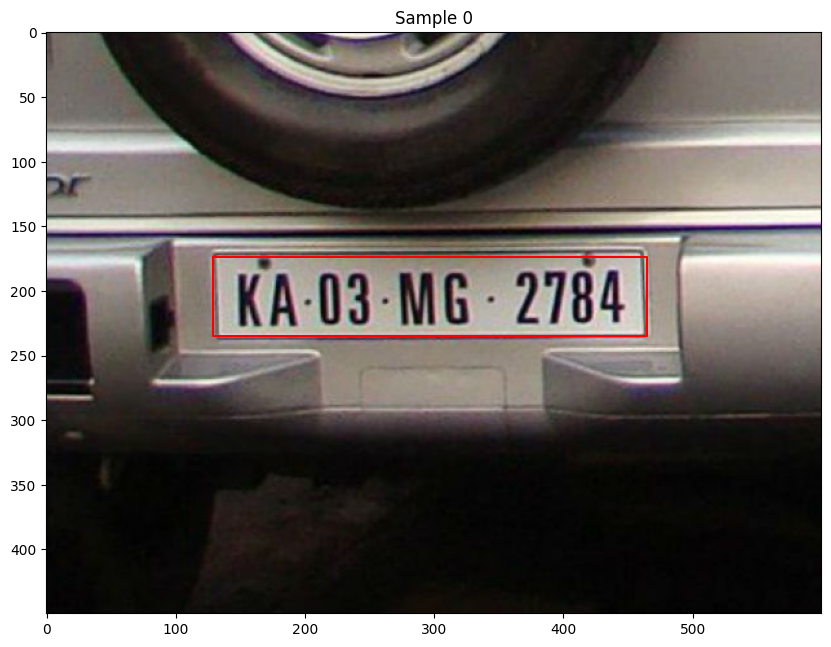

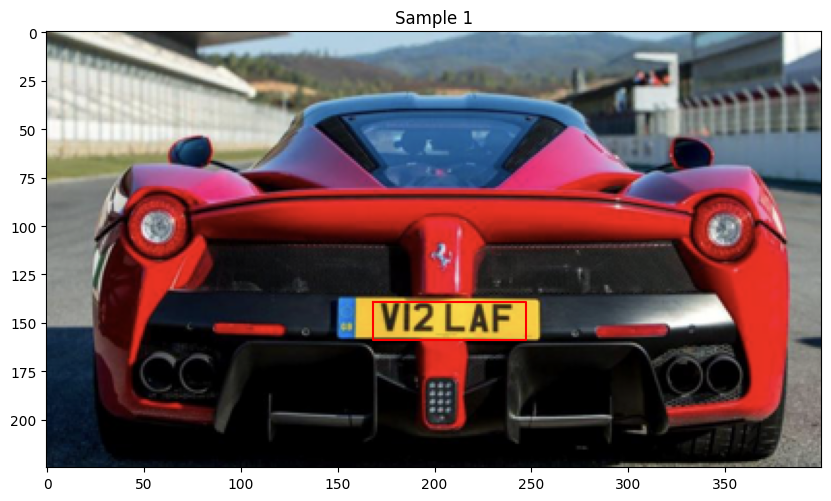

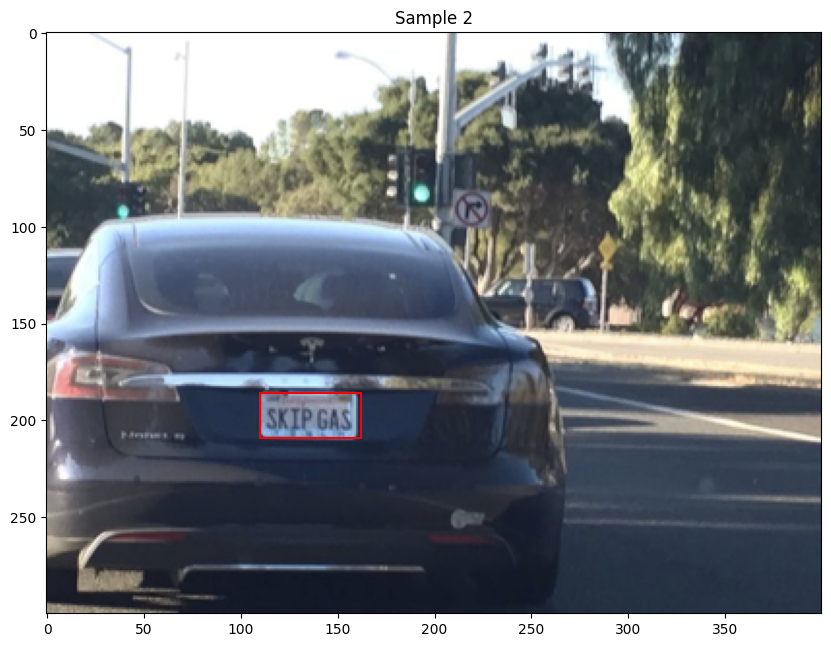

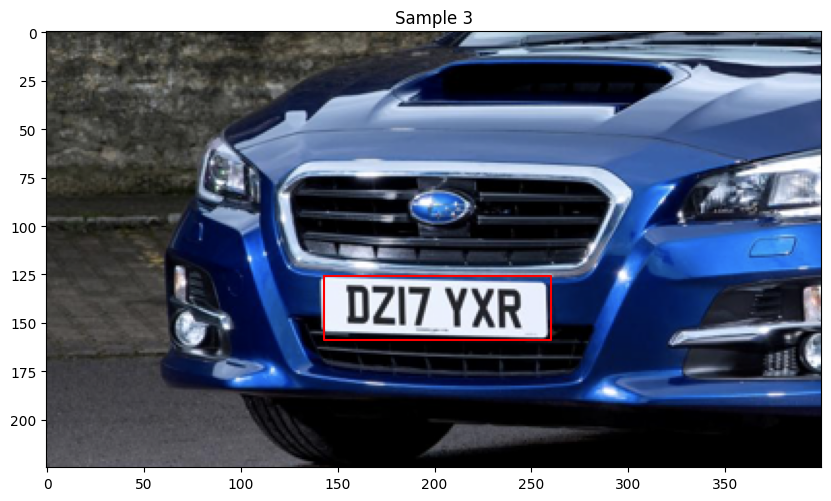

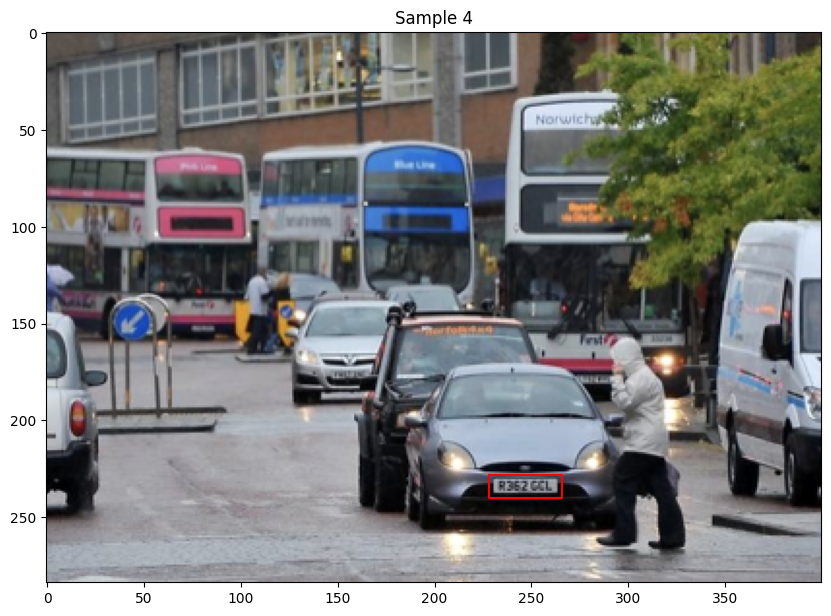

In [23]:
    # Visualize a few samples
    for i in range(5):
        visualize_sample(df, i, images_dir)

# Splitting Data

In [24]:
# Split into train and validation sets
train_df, val_df = train_test_split(df, test_size=0.2, random_state=42)


In [25]:
# Create TensorFlow datasets
train_dataset = tf.data.Dataset.from_tensor_slices((
    train_df['image_name'],
    train_df[['top_x', 'top_y', 'bottom_x', 'bottom_y']]
))
train_dataset = train_dataset.map(lambda x, y: load_data(x, y, images_dir), num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.map(augment_data, num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

In [26]:
val_dataset = tf.data.Dataset.from_tensor_slices((
    val_df['image_name'],
    val_df[['top_x', 'top_y', 'bottom_x', 'bottom_y']]
))
val_dataset = val_dataset.map(lambda x, y: load_data(x, y, images_dir), num_parallel_calls=tf.data.AUTOTUNE)
val_dataset = val_dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

In [27]:
# Learning Rate Schedule
class CyclicalLearningRate(tf.keras.optimizers.schedules.LearningRateSchedule):
    def __init__(self, initial_learning_rate, maximal_learning_rate, step_size):
        self.initial_learning_rate = tf.cast(initial_learning_rate, dtype=tf.float32)
        self.maximal_learning_rate = tf.cast(maximal_learning_rate, dtype=tf.float32)
        self.step_size = tf.cast(step_size, dtype=tf.float32)
        
    def __call__(self, step):
        step = tf.cast(step, dtype=tf.float32)
        cycle = tf.floor(1 + step / (2 * self.step_size))
        x = tf.abs(step / self.step_size - 2 * cycle + 1)
        return self.initial_learning_rate + (self.maximal_learning_rate - self.initial_learning_rate) * tf.maximum(tf.constant(0., dtype=tf.float32), (1 - x))
    
    def get_config(self):
        return {
            "initial_learning_rate": float(self.initial_learning_rate),
            "maximal_learning_rate": float(self.maximal_learning_rate),
            "step_size": float(self.step_size)
        }

    @classmethod
    def from_config(cls, config):
        return cls(**config)

In [28]:
# Create the optimizer with the learning rate schedule
initial_learning_rate = 1e-4
maximal_learning_rate = 1e-2
step_size = 2000  # Adjust based on your dataset size and batch size

lr_schedule = CyclicalLearningRate(initial_learning_rate, maximal_learning_rate, step_size)

In [29]:
# Compile the model
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss=combined_loss,
              metrics=[iou_metric])

# Model Training

In [30]:
# Callbacks
early_stopping = EarlyStopping(patience=50, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(factor=0.2, patience=20, min_lr=1e-6)
model_checkpoint = ModelCheckpoint('best_model_efficientnet.keras', save_best_only=True, save_weights_only=False)

# Train the model
history = model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=EPOCHS,
    callbacks=[early_stopping, reduce_lr, model_checkpoint]
)

Epoch 1/500


I0000 00:00:1729453131.242179     121 service.cc:145] XLA service 0x7821d80191e0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1729453131.242243     121 service.cc:153]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1729453131.242248     121 service.cc:153]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5


 1/11 ━━━━━━━━━━━━━━━━━━━━ 9:39 58s/step - iou_metric: 0.0073 - loss: 0.5362

I0000 00:00:1729453165.828629     121 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


11/11 ━━━━━━━━━━━━━━━━━━━━ 105s 5s/step - iou_metric: 0.0248 - loss: 0.5181 - val_iou_metric: 0.1530 - val_loss: 0.4379 - learning_rate: 1.0000e-04
Epoch 2/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 3s 283ms/step - iou_metric: 0.1113 - loss: 0.4618 - val_iou_metric: 0.1699 - val_loss: 0.4284 - learning_rate: 1.0000e-04
Epoch 3/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 4s 334ms/step - iou_metric: 0.1245 - loss: 0.4547 - val_iou_metric: 0.1923 - val_loss: 0.4159 - learning_rate: 1.0000e-04
Epoch 4/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 3s 293ms/step - iou_metric: 0.1454 - loss: 0.4418 - val_iou_metric: 0.1959 - val_loss: 0.4139 - learning_rate: 1.0000e-04
Epoch 5/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 3s 287ms/step - iou_metric: 0.1553 - loss: 0.4366 - val_iou_metric: 0.1994 - val_loss: 0.4122 - learning_rate: 1.0000e-04
Epoch 6/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 197ms/step - iou_metric: 0.1681 - loss: 0.4295 - val_iou_metric: 0.1868 - val_loss: 0.4189 - learning_rate: 1.0000e-04
Epoch 7/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 4s 328ms

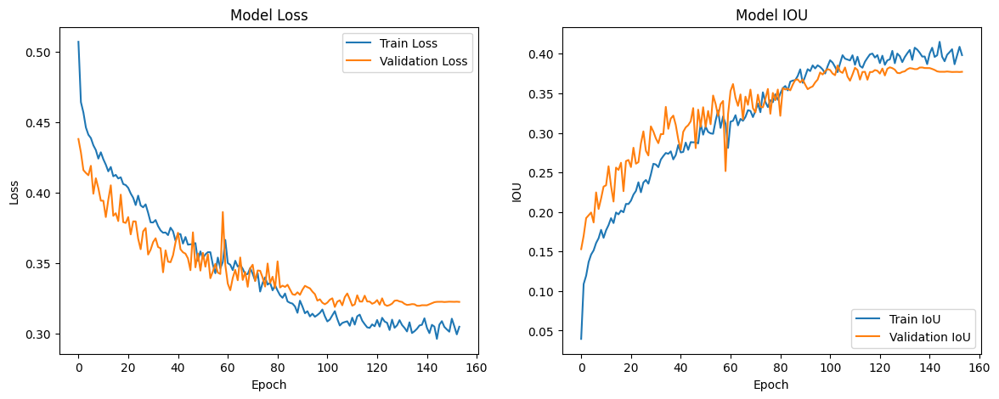

In [31]:
    # Plot loss
    plt.figure(figsize=(14, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    
    # Plot IoU metric
    plt.subplot(1, 2, 2)
    plt.plot(history.history['iou_metric'], label='Train IoU')
    plt.plot(history.history['val_iou_metric'], label='Validation IoU')
    plt.title('Model IOU')
    plt.ylabel('IOU')
    plt.xlabel('Epoch')
    plt.legend(loc='lower right')
    
    plt.show()

In [32]:
# Evaluate the model on the validation set
val_loss, val_iou = model.evaluate(val_dataset)
print(f"Final validation loss: {val_loss}")
print(f"Final validation IoU: {val_iou}")


3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - iou_metric: 0.3577 - loss: 0.3312
Final validation loss: 0.3188953995704651
Final validation IoU: 0.38522568345069885


# Fine Tune

In [33]:
# Gradually unfreeze and fine-tune
for layer in model.layers:
    layer.trainable = True

In [34]:

# Recompile the model with a lower learning rate for fine-tuning
model.compile(optimizer=Adam(learning_rate=1e-6), loss=combined_loss, metrics=[iou_metric])

In [35]:
# Continue training with unfrozen layers
history = model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=EPOCHS,
    initial_epoch=history.epoch[-1],
    callbacks=[early_stopping, model_checkpoint]
)

Epoch 154/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 145s 6s/step - iou_metric: 0.1625 - loss: 0.4358 - val_iou_metric: 0.3825 - val_loss: 0.3198
Epoch 155/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 200ms/step - iou_metric: 0.1624 - loss: 0.4355 - val_iou_metric: 0.3794 - val_loss: 0.3211
Epoch 156/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 206ms/step - iou_metric: 0.1653 - loss: 0.4342 - val_iou_metric: 0.3751 - val_loss: 0.3230
Epoch 157/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 209ms/step - iou_metric: 0.1571 - loss: 0.4376 - val_iou_metric: 0.3677 - val_loss: 0.3267
Epoch 158/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 202ms/step - iou_metric: 0.1638 - loss: 0.4358 - val_iou_metric: 0.3583 - val_loss: 0.3315
Epoch 159/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 203ms/step - iou_metric: 0.1617 - loss: 0.4360 - val_iou_metric: 0.3498 - val_loss: 0.3358
Epoch 160/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 204ms/step - iou_metric: 0.1579 - loss: 0.4381 - val_iou_metric: 0.3436 - val_loss: 0.3391
Epoch 161/500
11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 201ms/step -

# Print Losses

In [36]:
# Evaluate the model on the validation set
val_loss, val_iou = model.evaluate(val_dataset)
print(f"Final validation loss: {val_loss}")
print(f"Final validation IoU: {val_iou}")

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - iou_metric: 0.3577 - loss: 0.3310
Final validation loss: 0.3198143541812897
Final validation IoU: 0.3825486898422241


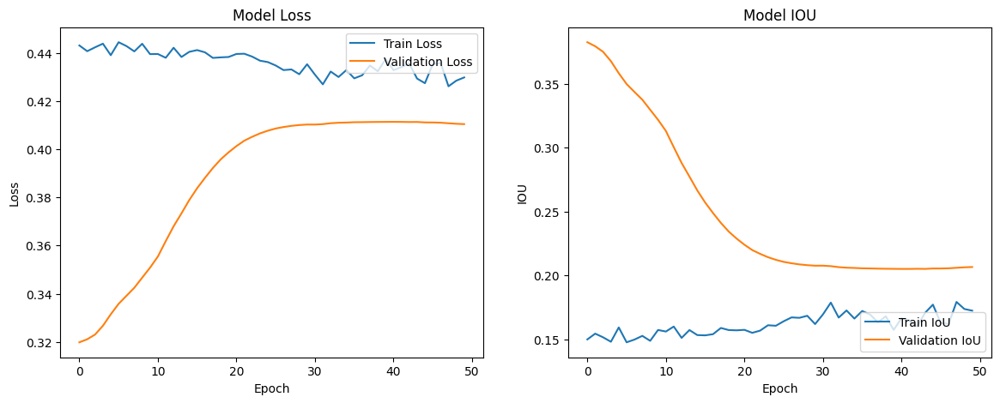

In [37]:
    # Plot loss
    plt.figure(figsize=(14, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    
    # Plot IoU metric
    plt.subplot(1, 2, 2)
    plt.plot(history.history['iou_metric'], label='Train IoU')
    plt.plot(history.history['val_iou_metric'], label='Validation IoU')
    plt.title('Model IOU')
    plt.ylabel('IOU')
    plt.xlabel('Epoch')
    plt.legend(loc='lower right')
    
    plt.show()

# Visualizing and make sure that predicted box is like the Ground Truth Box

In [38]:
# Add this function to visualize predictions
def visualize_prediction(model, df, index, images_dir):
    sample = df.iloc[index]
    img_path = os.path.join(images_dir, sample['image_name'])
    
    # Load and preprocess the image
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]
    
    # Prepare the image for model prediction
    image_input = preprocess_image(img_path)
    image_input = tf.expand_dims(image_input, axis=0)  # Add batch dimension

    # Get model predictions
    pred_bbox = model.predict(image_input)[0]  # Get first (and only) batch

    # Denormalize the predicted bounding box
    pred_xmin, pred_ymin, pred_xmax, pred_ymax = pred_bbox * np.array([w, h, w, h])

    plt.figure(figsize=(10, 10))
    plt.imshow(img_rgb)

    # Draw ground truth box
    plt.plot([sample['top_x']*w, sample['bottom_x']*w, sample['bottom_x']*w, sample['top_x']*w, sample['top_x']*w],
             [sample['top_y']*h, sample['top_y']*h, sample['bottom_y']*h, sample['bottom_y']*h, sample['top_y']*h], 'r-', label='Ground Truth')

    # Draw predicted box
    plt.plot([pred_xmin, pred_xmax, pred_xmax, pred_xmin, pred_xmin],
             [pred_ymin, pred_ymin, pred_ymax, pred_ymax, pred_ymin], 'g-', label='Predicted')

    plt.title(f"Sample {index} - Ground Truth (Red) vs Predicted (Green)")
    plt.legend()
    plt.axis('off')
    plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


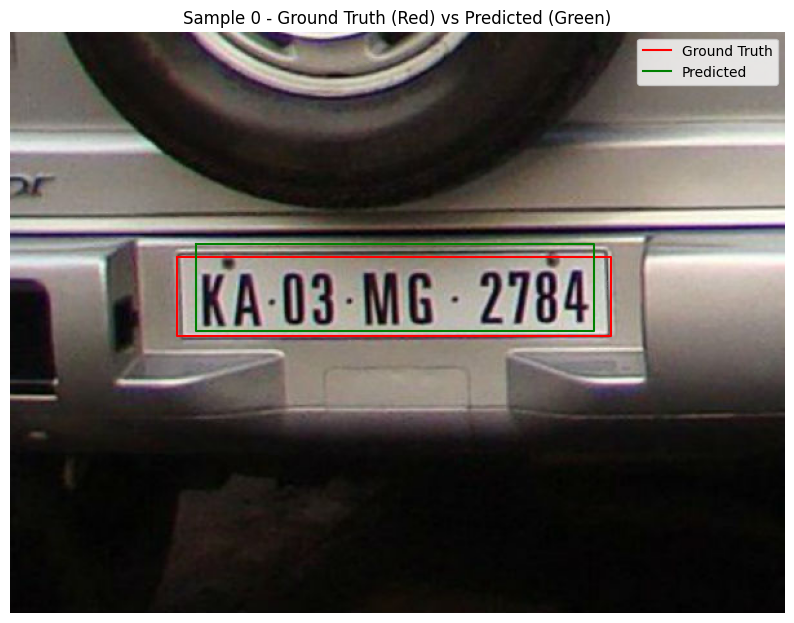

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


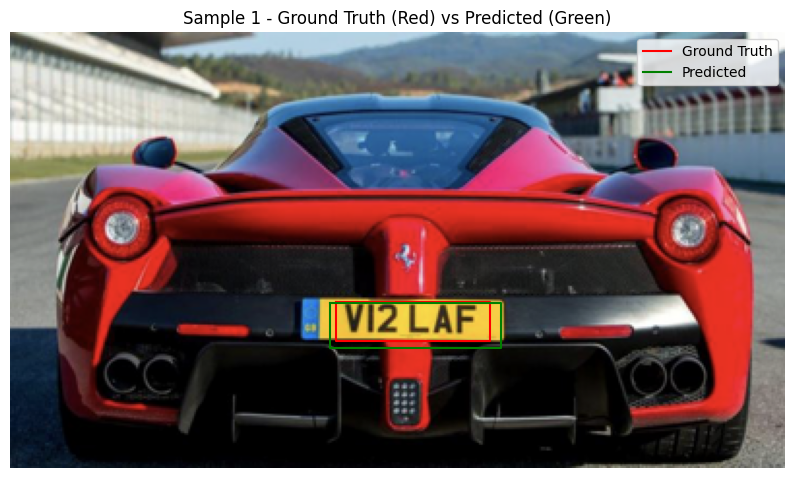

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


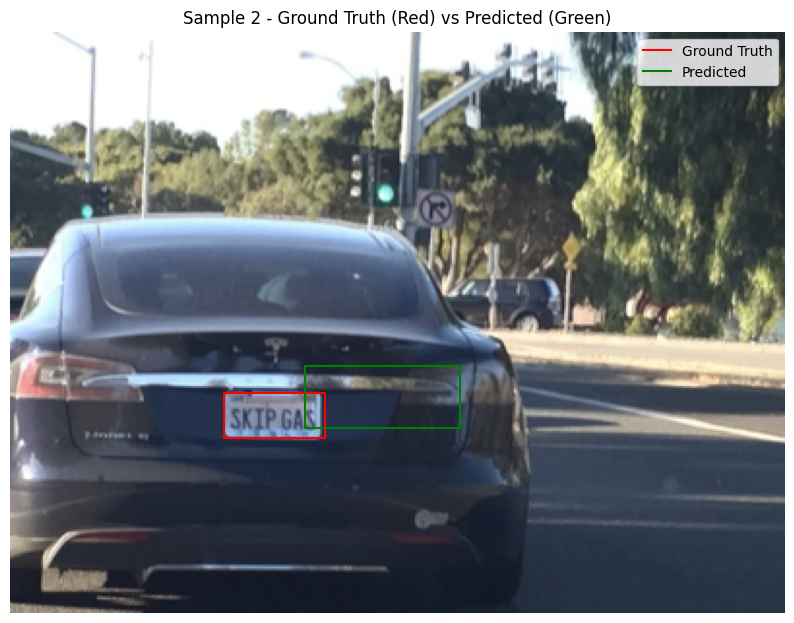

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


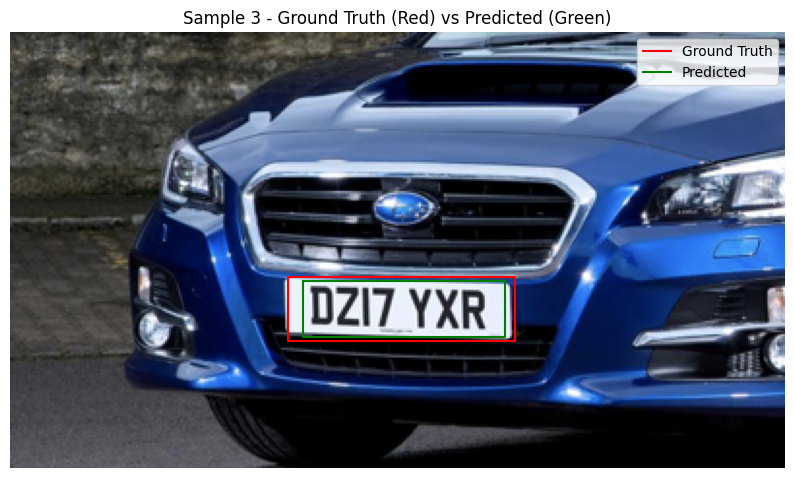

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


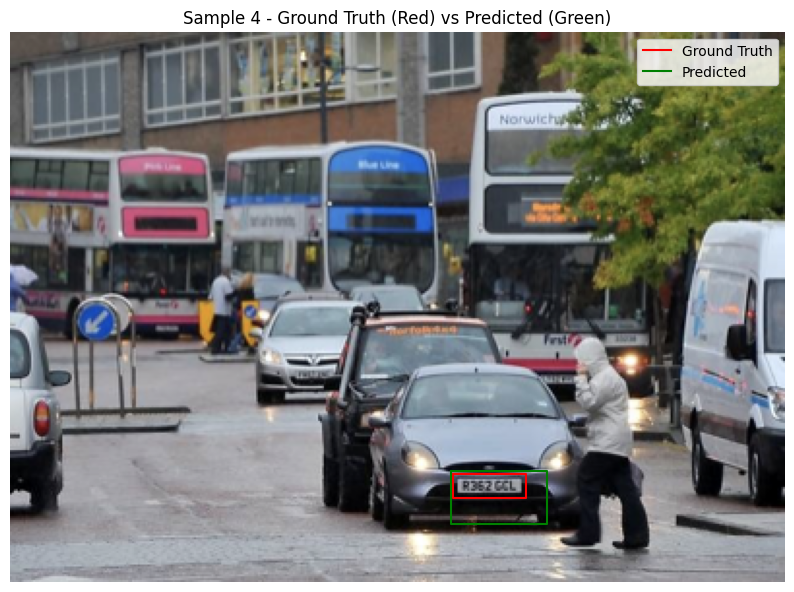

In [39]:
# Example usage of the visualize_prediction function
for i in range(5):  # Visualize predictions for the first 5 samples
    visualize_prediction(model, df, i, images_dir)

In [40]:
# Function to show an image with bounding box
def show_img(image, bbox, title):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, (IMAGE_SIZE, IMAGE_SIZE))

    tx, ty, bx, by = bbox
    tx, ty, bx, by = int(tx * IMAGE_SIZE), int(ty * IMAGE_SIZE), int(bx * IMAGE_SIZE), int(by * IMAGE_SIZE)

    image = cv2.rectangle(image, (tx, ty), (bx, by), (0, 255, 0), 2)
    plt.figure(figsize=(8, 8))
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')
    plt.show()

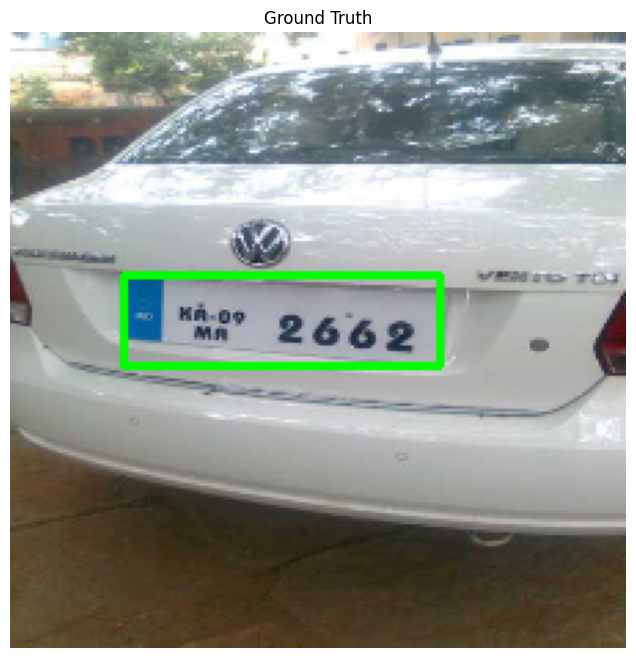

In [41]:
# Show a sample image with ground truth bounding box
sample_index = 5
sample_image_path = os.path.join(images_dir, val_df["image_name"].iloc[sample_index])
sample_image = cv2.imread(sample_image_path)
ground_truth_bbox = val_df.iloc[sample_index][['top_x', 'top_y', 'bottom_x', 'bottom_y']].values

show_img(sample_image, ground_truth_bbox, "Ground Truth")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


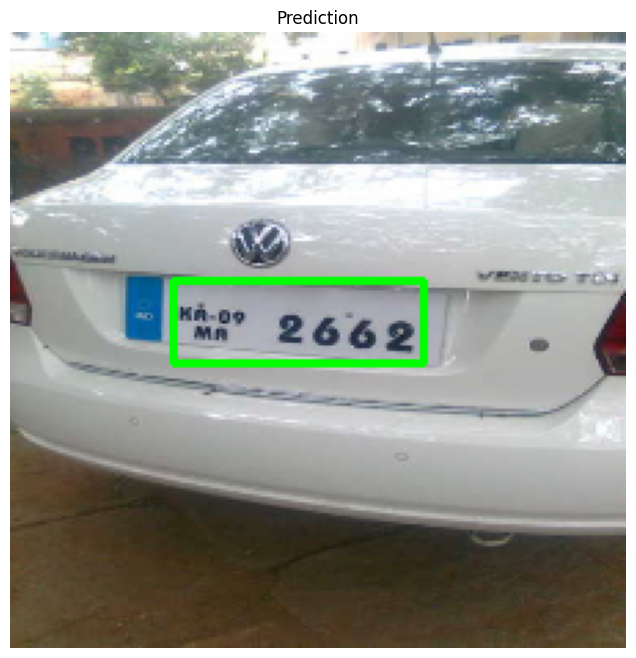

In [42]:
# Make predictions on the sample image
sample_image_tensor = preprocess_image(sample_image_path)
sample_image_tensor = tf.expand_dims(sample_image_tensor, 0)
prediction = model.predict(sample_image_tensor)[0]

# Display the prediction
show_img(sample_image, prediction, "Prediction")

# Another Way to Visuallize

In [43]:
# Function to visualize predictions
def visualize_prediction(image_path, true_bbox, pred_bbox):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]
    
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    
    # True bounding box
    plt.plot([true_bbox[0]*w, true_bbox[2]*w, true_bbox[2]*w, true_bbox[0]*w, true_bbox[0]*w],
             [true_bbox[1]*h, true_bbox[1]*h, true_bbox[3]*h, true_bbox[3]*h, true_bbox[1]*h], 'r-', label='True')
    
    # Predicted bounding box
    plt.plot([pred_bbox[0]*w, pred_bbox[2]*w, pred_bbox[2]*w, pred_bbox[0]*w, pred_bbox[0]*w],
             [pred_bbox[1]*h, pred_bbox[1]*h, pred_bbox[3]*h, pred_bbox[3]*h, pred_bbox[1]*h], 'g-', label='Predicted')
    
    plt.legend()
    plt.title(f"IoU: {iou_metric(np.array([true_bbox]), np.array([pred_bbox])).numpy():.4f}")
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


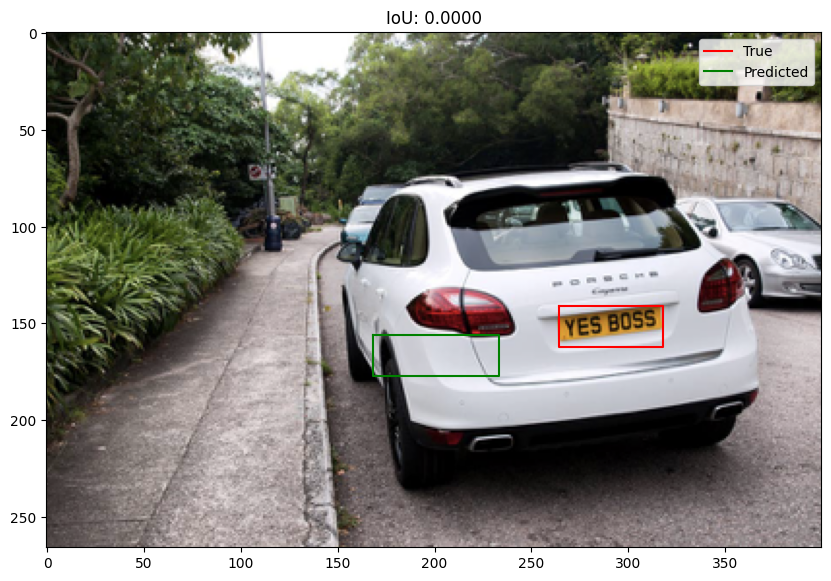

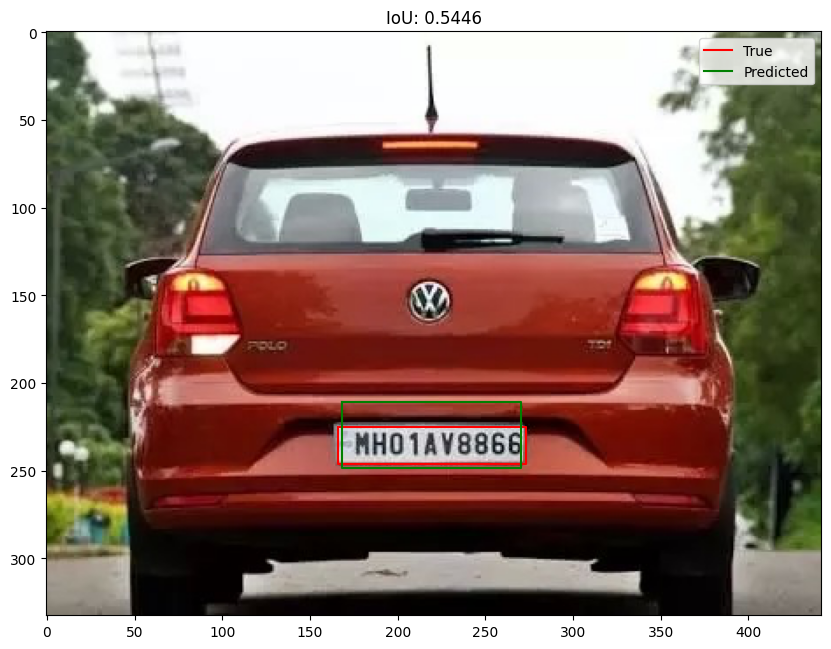

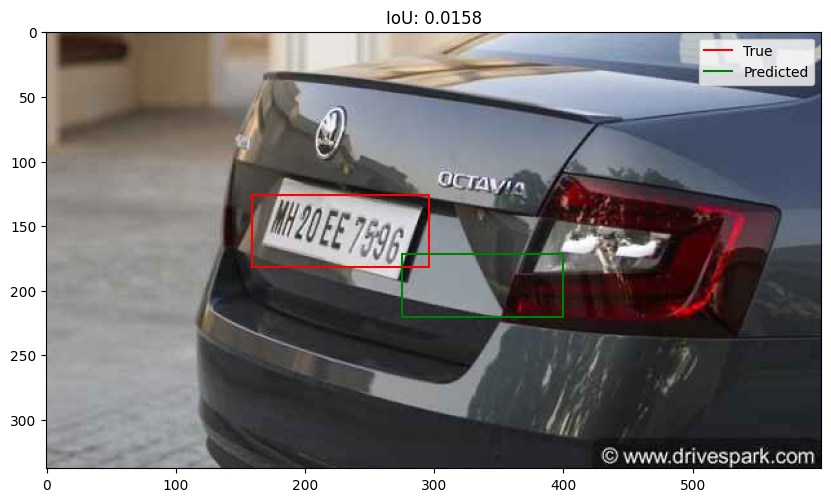

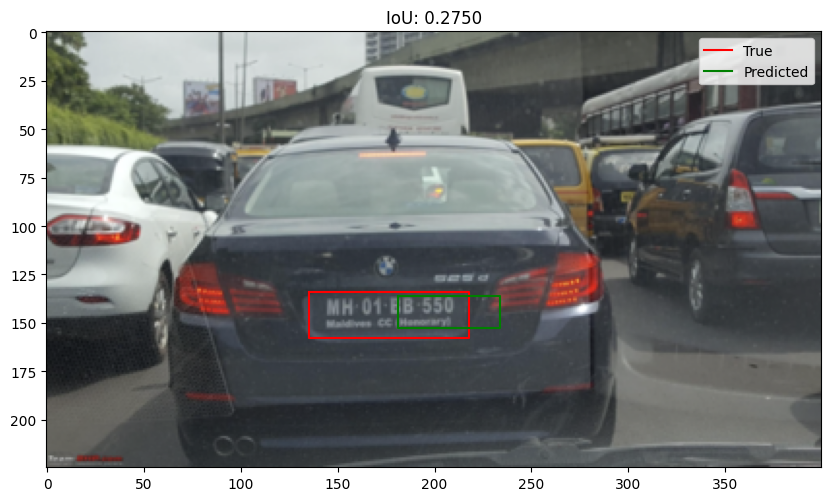

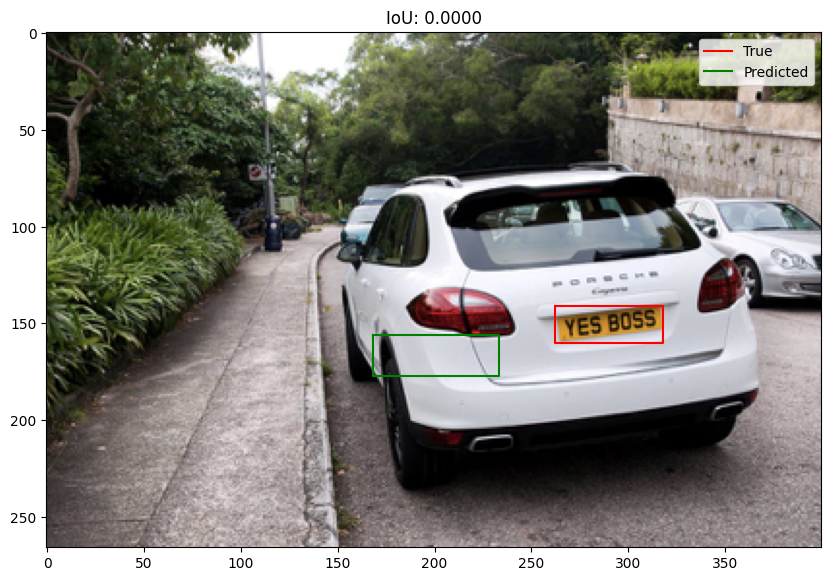

...

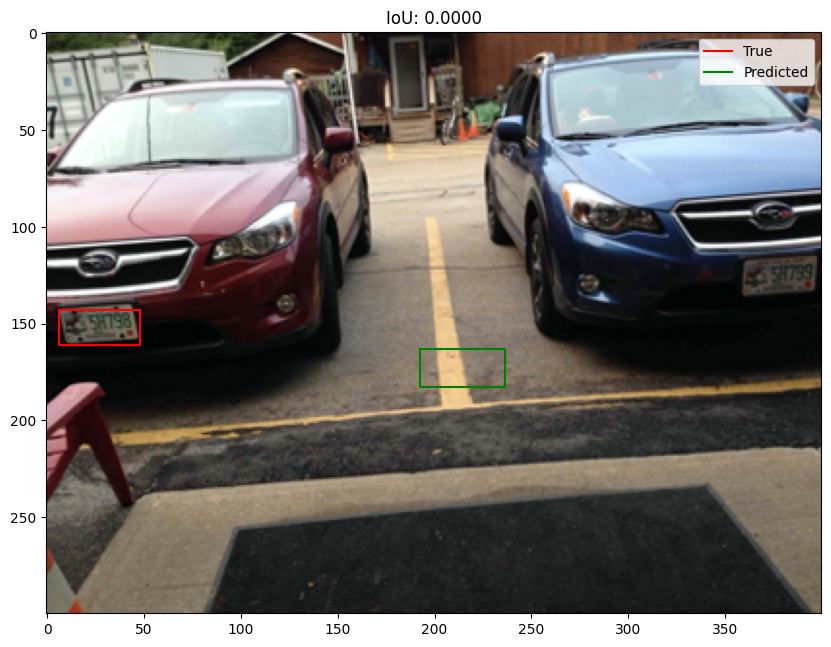

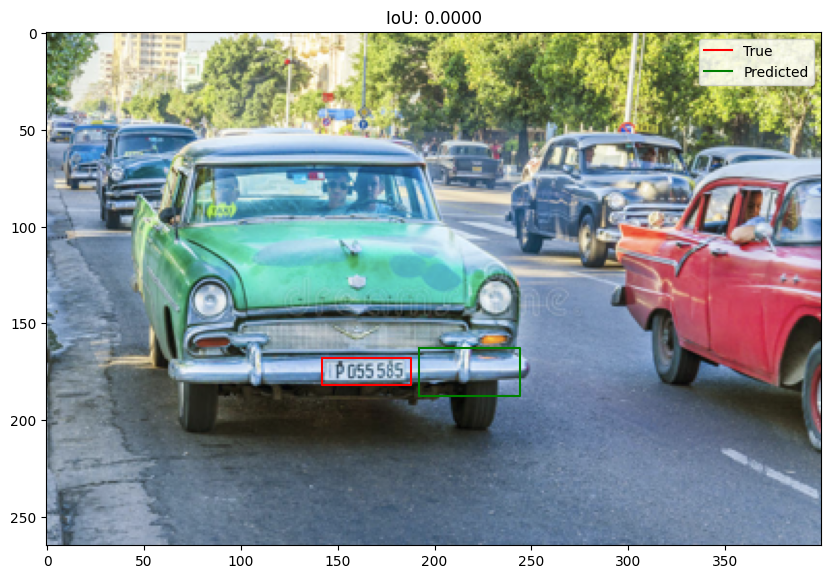

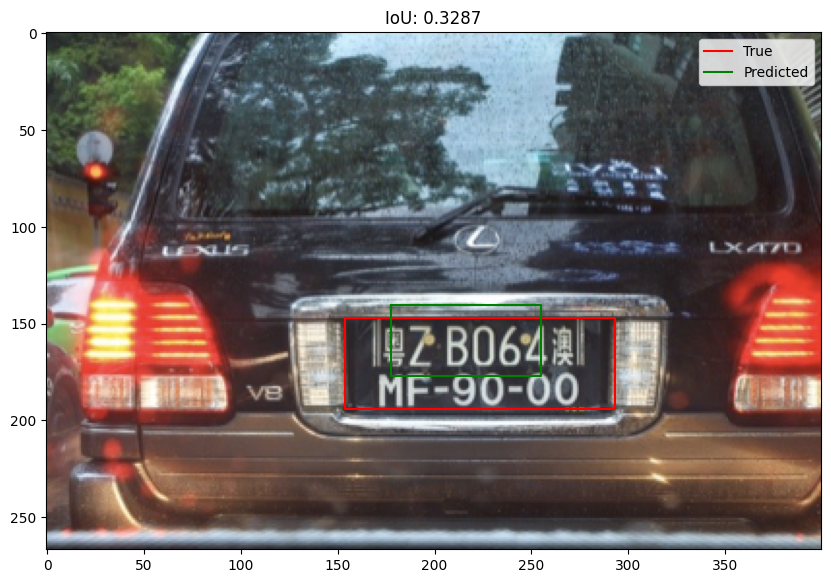

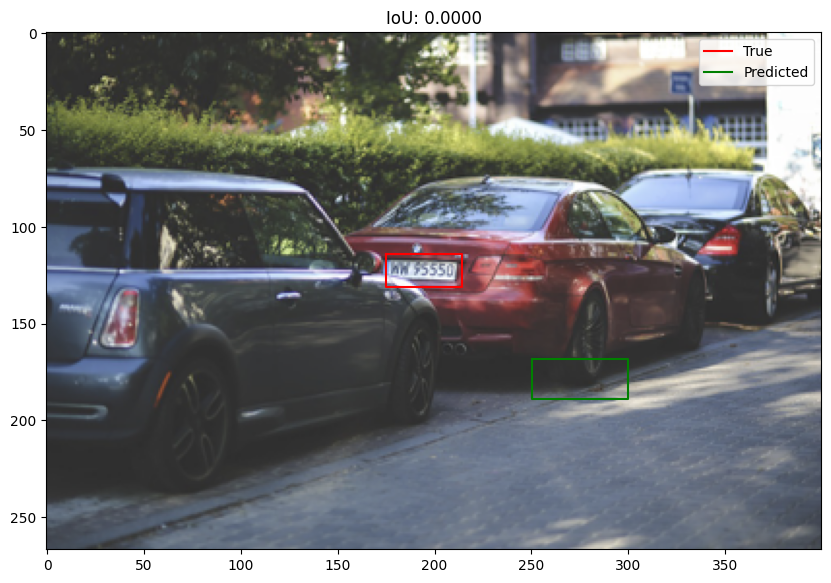

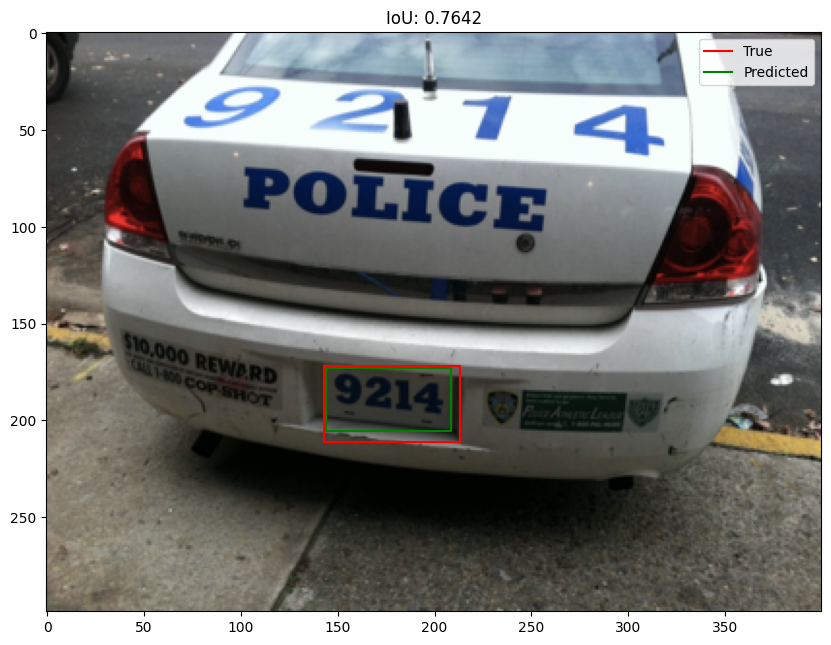

In [44]:
# Make predictions on validation set
for image_batch, true_bbox_batch in val_dataset.take(1):
    pred_bbox_batch = model.predict(image_batch)
    
    for i in range(len(image_batch)):
        image_path = os.path.join(images_dir, val_df['image_name'].iloc[i])
        visualize_prediction(image_path, true_bbox_batch[i].numpy(), pred_bbox_batch[i])


# Difference Between Ground Truth Box & Predicted by Intersection of Union (IOU) 

In [45]:
# Print some sample predictions with IoU
for image_batch, true_bbox_batch in val_dataset.take(1):
    pred_bbox_batch = model.predict(image_batch)
    for true_bbox, pred_bbox in zip(true_bbox_batch, pred_bbox_batch):
        iou = iou_metric(np.array([true_bbox]), np.array([pred_bbox])).numpy()
        print(f"True bbox: {true_bbox.numpy()}")
        print(f"Predicted bbox: {pred_bbox}")
        print(f"IoU: {iou:.4f}")
        print("---")



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
True bbox: [0.66       0.53007519 0.795      0.60902256]
Predicted bbox: [0.42111254 0.5862208  0.5832115  0.6653041 ]
IoU: 0.0000
---
True bbox: [0.37556561 0.67567568 0.61764706 0.73873874]
Predicted bbox: [0.38043636 0.6325871  0.61208683 0.7455496 ]
IoU: 0.5446
---
True bbox: [0.265      0.37278107 0.49333333 0.53846154]
Predicted bbox: [0.45810428 0.5086705  0.66667867 0.6516293 ]
IoU: 0.0158
---
True bbox: [0.3375     0.59555556 0.545      0.70222222]
Predicted bbox: [0.45289665 0.60426635 0.58488846 0.6793018 ]
IoU: 0.2750
---
True bbox: [0.655      0.53007519 0.795      0.60150376]
Predicted bbox: [0.42111254 0.5862208  0.5832115  0.6653041 ]
IoU: 0.0000
---
True bbox: [0.18666667 0.396      0.69866667 0.542     ]
Predicted bbox: [0.26646674 0.40498027 0.6735984  0.53692997]
IoU: 0.7187
---
True bbox: [0.636      0.52054795 0.692      0.61369863]
Predicted bbox: [0.5305082  0.62515914 0.7231217  0.7374163 ]
IoU: 0.0000
---
True bbox: [0.5  

In [46]:
# Function to calculate IoU
def calculate_iou(box1, box2):
    x1, y1, x2, y2 = box1
    x3, y3, x4, y4 = box2

    intersection_x = max(0, min(x2, x4) - max(x1, x3))
    intersection_y = max(0, min(y2, y4) - max(y1, y3))
    intersection_area = intersection_x * intersection_y

    box1_area = (x2 - x1) * (y2 - y1)
    box2_area = (x4 - x3) * (y4 - y3)

    union_area = box1_area + box2_area - intersection_area

    iou = intersection_area / union_area if union_area > 0 else 0
    return iou


In [47]:
# Calculate and print IoU
iou = calculate_iou(ground_truth_bbox, prediction)
print(f"IoU between ground truth and prediction: {iou:.4f}")


IoU between ground truth and prediction: 0.7187


In [48]:
# Visualize both bounding boxes on the same image
def show_comparison(image, ground_truth, prediction):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, (IMAGE_SIZE, IMAGE_SIZE))

    # Ground truth bounding box (red)
    tx, ty, bx, by = [int(coord * IMAGE_SIZE) for coord in ground_truth]
    image = cv2.rectangle(image, (tx, ty), (bx, by), (255, 0, 0), 2)

    # Predicted bounding box (green)
    tx, ty, bx, by = [int(coord * IMAGE_SIZE) for coord in prediction]
    image = cv2.rectangle(image, (tx, ty), (bx, by), (0, 255, 0), 2)

    plt.figure(figsize=(8, 8))
    plt.imshow(image)
    plt.title(f"Comparison (IoU: {iou:.4f})")
    plt.legend(['Ground Truth', 'Prediction'])
    plt.axis('off')
    plt.show()

# Comparison

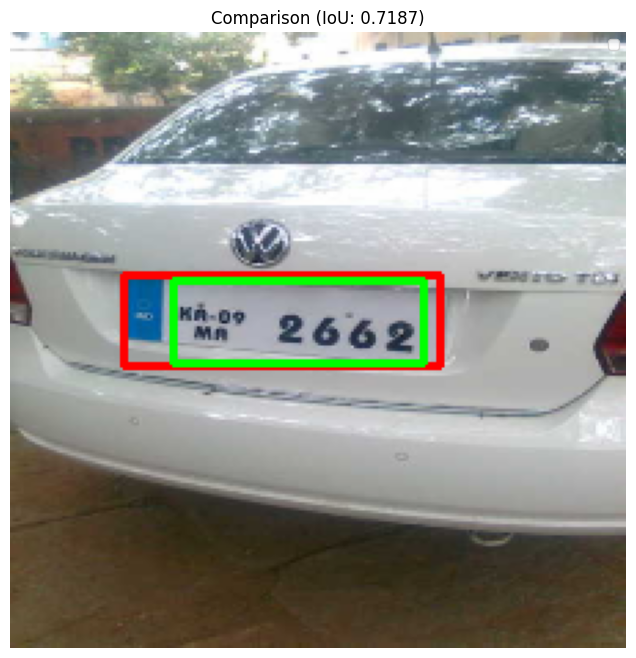

In [49]:
# Show comparison
show_comparison(sample_image, ground_truth_bbox, prediction)



# Saving Model

In [50]:
    # Save the model

    model.save('license_plate_detection_model.h5')

# Visulaizing our box with Another way

In [51]:
# Prediction and visualization function

def visualize_predictions(model, dataset, num_samples=3):

    for images, true_boxes in dataset.take(1):

        predictions = model.predict(images)



        for i in range(min(num_samples, len(images))):

            img = images[i].numpy()

            img = (img - img.min()) / (img.max() - img.min())  # Denormalize the image



            true_box = true_boxes[i].numpy()

            pred_box = predictions[i]



            plt.figure(figsize=(10, 10))

            plt.imshow(img)



            # Draw true bounding box

            plt.gca().add_patch(plt.Rectangle((true_box[0]*IMAGE_SIZE, true_box[1]*IMAGE_SIZE),

                                              (true_box[2]-true_box[0])*IMAGE_SIZE,

                                              (true_box[3]-true_box[1])*IMAGE_SIZE,

                                              fill=False, edgecolor='b', linewidth=2))



            # Draw predicted bounding box

            plt.gca().add_patch(plt.Rectangle((pred_box[0]*IMAGE_SIZE, pred_box[1]*IMAGE_SIZE),

                                              (pred_box[2]-pred_box[0])*IMAGE_SIZE,

                                              (pred_box[3]-pred_box[1])*IMAGE_SIZE,

                                              fill=False, edgecolor='r', linewidth=2))



            plt.title(f"True (Blue) vs Predicted (Red)")

            plt.axis('off')

            plt.show()



            print(f"True box: {true_box}")

            print(f"Predicted box: {pred_box}")

            print(f"IoU: {calculate_iou(true_box, pred_box):.4f}")

            print("---")

In [52]:
def calculate_iou(box1, box2):

    x1 = max(box1[0], box2[0])

    y1 = max(box1[1], box2[1])

    x2 = min(box1[2], box2[2])

    y2 = min(box1[3], box2[3])



    intersection = max(0, x2 - x1) * max(0, y2 - y1)

    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])

    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])



    iou = intersection / (box1_area + box2_area - intersection + 1e-6)

    return iou

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


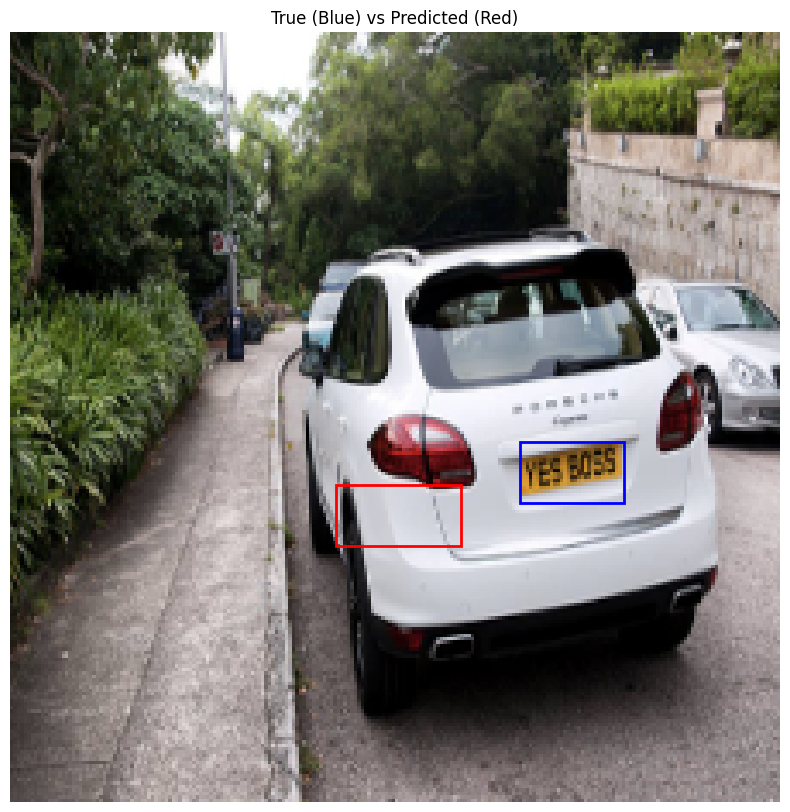

True box: [0.66       0.53007519 0.795      0.60902256]
Predicted box: [0.42111254 0.5862208  0.5832115  0.6653041 ]
IoU: 0.0000
---


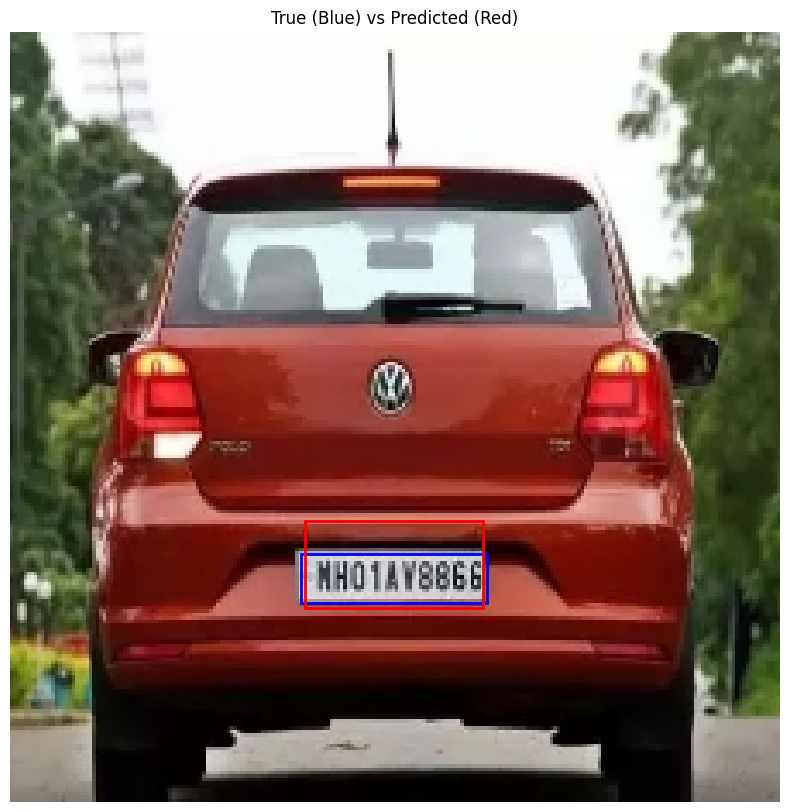

True box: [0.37556561 0.67567568 0.61764706 0.73873874]
Predicted box: [0.38043636 0.6325871  0.61208683 0.7455496 ]
IoU: 0.5446
---


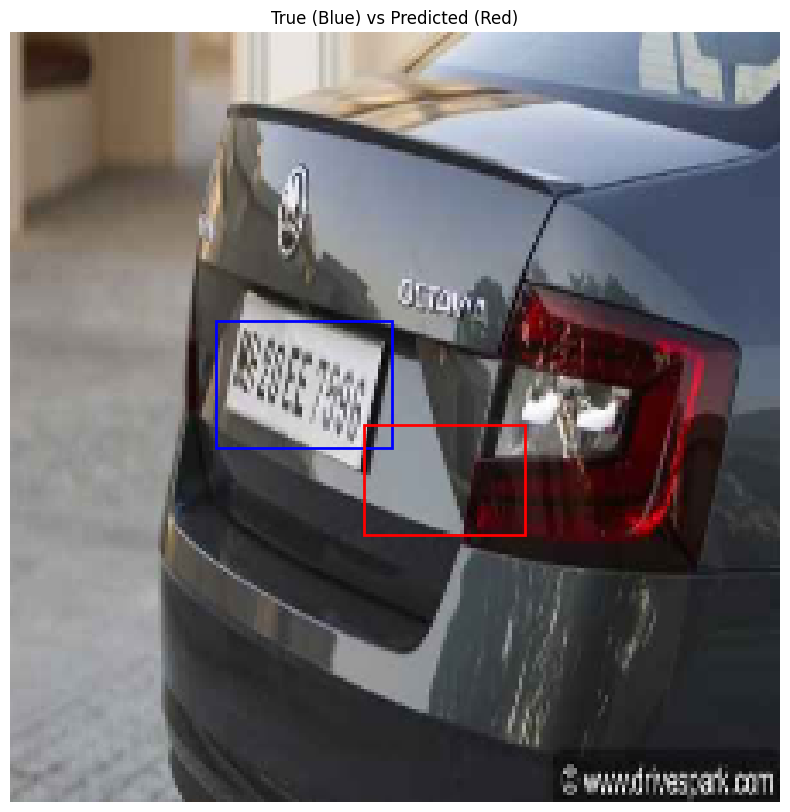

True box: [0.265      0.37278107 0.49333333 0.53846154]
Predicted box: [0.45810428 0.5086705  0.66667867 0.6516293 ]
IoU: 0.0158
---


In [53]:
# Visualize predictions

visualize_predictions(model, val_dataset)